# longyearbyen_test

In [316]:
%load_ext autoreload
%autoreload 2
#import os
#import sys
#module_path = os.path.abspath(os.path.join('..'))
#if module_path not in sys.path:
#    sys.path.append(module_path)
#import oogeso
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import cloudpickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO
#print("Using Oogeso version {}".format(oogeso.__version__))

import pickle

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Read input data

In [317]:
first = pd.read_csv('../tests/test_data/LYR_load.csv')
second = pd.read_csv('../tests/test_data/cap_factors_1hr_airport.csv')
third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')

merged = pd.merge(first, second, how='left', on='timestamp')
merged = pd.merge(merged, third, how='left', on='timestamp')
merged.fillna(0,inplace=True)
#merged.to_csv('../tests/test_data/profiles_merged.csv', index=False)

In [318]:
merged

,timestamp,el_load,heat_load,V25,V47,TUGE50,TUGE10,MPR,local_time,PV
0,2017-01-01 00:00:00,4.81,7.466778,0.000000,0.000000,0.000000,0.000000,0.000000,2017-01-01 01:00:00,0.0
1,2017-01-01 01:00:00,4.33,7.551868,0.399499,0.556632,0.677735,0.782709,0.470756,2017-01-01 02:00:00,0.0
2,2017-01-01 02:00:00,4.54,7.573140,0.399499,0.556632,0.677735,0.782709,0.470756,2017-01-01 03:00:00,0.0
3,2017-01-01 03:00:00,4.69,7.573140,0.307258,0.445659,0.612891,0.685810,0.360826,2017-01-01 04:00:00,0.0
4,2017-01-01 04:00:00,4.30,7.573140,0.293578,0.427252,0.602084,0.669441,0.343439,2017-01-01 05:00:00,0.0
...,...,...,...,...,...,...,...,...,...,...
17515,2018-12-31 19:00:00,5.26,10.139872,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 20:00:00,0.0
17516,2018-12-31 20:00:00,5.16,9.826704,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 21:00:00,0.0
17517,2018-12-31 21:00:00,5.12,9.640496,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 22:00:00,0.0
17518,2018-12-31 22:00:00,4.99,9.513536,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 23:00:00,0.0


In [319]:
#case='base' # base case without wind
#case='A' # case with 24 MW wind capacity
#case='B' # case with 24 MW wind capacity AND 4 MW, 4 MWh battery
#case="_base_test"
case="_ir_offshore_pv"
case="_ir_offshore_pv_diesel"
#case="all"
#timerange=[0,12*24*7] #one week (with 5 min timestep)
timerange=[0,24*365] #one year (with 1 hour timestep)
timerange=[0,24*7] #one week (with 1 hour timestep)
#timerange=[0,4]
#timerange=[1030,1050] #no wind period

outpath = "result/"
plots.plotter="plotly"

data = file_io.read_data_from_yaml('../tests/test_data/longyearbyen_test.yaml')

incl_battery=0
incl_hydrogen=0
incl_diesel=0

if case=="_ir_offshore_pv":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    data.parameters.co2_tax=1000
    #prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    #data.profiles.append(prof_h2target)

elif case=="_ir_offshore_pv_diesel":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*3 # MW, 3 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=0
    incl_battery=1
    incl_diesel=1
    data.parameters.co2_tax=1000

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

#data['paramParameters']['planning_horizon']=12

if case=="base_test":
    wind_P_max=0.66*8 # Some turbines
    pv_P_max=25 # MWp Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    data.parameters.co2_tax=1000
    #prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    #data.profiles.append(prof_h2target)
elif case=="all":
    # CASE for illustration (to make plots for paper)
    wind_P_max=8*12 # Large wind farm Pmax=2x demand
    incl_battery=1
    incl_hydrogen=1
    data.parameters.co2_tax=1000
    prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    data.profiles.append(prof_h2target)


hydrogendevices = ['electrolyser','fuelcell','h2_storage']
dieseldevices = ['diesel_source','backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3','diesel_boiler_1','diesel_boiler_2','boiler_houses']
for dev in data.devices:
    if dev.id == "wind":
        dev.flow_max = wind_P_max
        dev.profile = wind_profile
    if dev.id == "pv":
        dev.flow_max = pv_P_max
    if dev.id == "el_storage":
        dev.include = incl_battery
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
    if dev.id in dieseldevices:
        dev.include = incl_diesel

simulator = oogeso.Simulator(data)

In [320]:
for dev in data.devices:
    if dev.id=='el_load':
        print(dev)

id='el_load' node_id='load' name='general el load' include=True profile='el_load' flow_min=1.0 flow_max=1.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=0.0 op_cost=None penalty_function=None model=<ModelType.SINK_EL: 'sinkel'>


In [321]:
# Test solve:
simulator.optimiser.solve(solver="gurobi")

{'Problem': [{'Name': 'x129619', 'Lower bound': 0.00797499999988285, 'Upper bound': 0.007975000000000001, 'Number of objectives': 1, 'Number of constraints': 31897, 'Number of variables': 30481, 'Number of binary variables': 8160, 'Number of integer variables': 8160, 'Number of continuous variables': 22321, 'Number of nonzeros': 68055, 'Sense': 'minimize'}], 'Solver': [{'Status': 'ok', 'Return code': '0', 'Message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Termination condition': 'optimal', 'Termination message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Wall time': '0.329010009765625', 'Error rc': 0, 'Time': 1.4675259590148926}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

In [322]:
#simulator.optimiser.constr_diesel_source_flowMin.pprint()

In [323]:
simulator.optimiser.paramDeviceEnergyInitially.pprint()

paramDeviceEnergyInitially : Size=18, Index=setDevice, Domain=Reals, Default=None, Mutable=True
    Key             : Value
      backup_east_1 :     0
      backup_east_2 :     0
      backup_east_3 :     0
      backup_west_1 :     0
      backup_west_2 :     0
      backup_west_3 :     0
      boiler_houses :     0
    diesel_boiler_1 :     0
    diesel_boiler_2 :     0
      diesel_source :     0
            el_dump :     0
            el_load :     0
         el_storage :   3.0
          heat_dump :     0
          heat_load :     0
           heatpump :     0
                 pv :     0
               wind :     0


In [324]:
simulator.optimiser.dual.pprint()

dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
    Key : Value


In [325]:
simulator.optimiser.paramProfiles.pprint() # all 1 before update, from profile after
simulator.optimiser.paramDeviceIsOnInitially.pprint() # all 1 before and after update
simulator.optimiser.paramDevicePrepTimestepsInitially.pprint() # all 0 before and after update
simulator.optimiser.paramDevicePowerInitially.pprint() # unchanged before/after

paramProfiles : Size=960, Index=paramProfiles_index, Domain=Reals, Default=None, Mutable=True
    Key                : Value
             ('PV', 0) :     1
             ('PV', 1) :     1
             ('PV', 2) :     1
             ('PV', 3) :     1
             ('PV', 4) :     1
             ('PV', 5) :     1
             ('PV', 6) :     1
             ('PV', 7) :     1
             ('PV', 8) :     1
             ('PV', 9) :     1
            ('PV', 10) :     1
            ('PV', 11) :     1
            ('PV', 12) :     1
            ('PV', 13) :     1
            ('PV', 14) :     1
            ('PV', 15) :     1
            ('PV', 16) :     1
            ('PV', 17) :     1
            ('PV', 18) :     1
            ('PV', 19) :     1
            ('PV', 20) :     1
            ('PV', 21) :     1
            ('PV', 22) :     1
            ('PV', 23) :     1
            ('PV', 24) :     1
            ('PV', 25) :     1
            ('PV', 26) :     1
            ('PV', 27) :     1
       

### Inspect input data

In [326]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(asdict(data)[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [327]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [328]:
for e in data.edges: print(e.id,e.bidirectional)

el_wf_ps True
el_ps_load True
heat_h2_load True
el_ps_h2 True
el_ps_hp True
heat_hp_load True
el_diesel_load True
heat_diesel_load True


0 2016


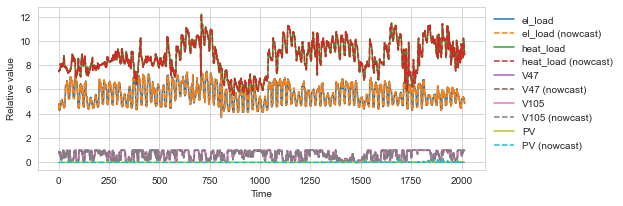

In [329]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,3))
ax=plt.gca()
#day 6, hour 22: 6*24*12 + 22*12 = 
#tstart=7*24*12
#tlen=12*12
#xvalues = pd.date_range(start="00:00:00",freq="5min",periods=tlen)
#myFmt = mdates.DateFormatter('%H:%M')
#ax.xaxis.set_major_formatter(myFmt)
tstart=0
tlen=7*24*12
xvalues=range(tstart,tstart+tlen)
print(tstart,tlen)
for pr in profiles:
    if pr.id in ["curve_const","waterinj","h2target"]: continue
    color = next(ax._get_lines.prop_cycler)['color']
    plt.step(xvalues,pr.data[tstart:(tstart+tlen)],label=pr.id,color=color,where="post")
    if pr.data_nowcast is not None:
        color = next(ax._get_lines.prop_cycler)['color']
        plt.step(xvalues,pr.data_nowcast[tstart:(tstart+tlen)],"--",
                 label="{} (nowcast)".format(pr.id),color=color,where="post")        
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
plt.xlabel("Time")
plt.ylabel("Relative value")
plt.savefig(outpath+"timerseries_ts{}_{}.pdf".format(tstart,case),dpi=300,bbox_inches="tight")

In [330]:
outpath

'result/'

In [331]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

In [332]:
dev=simulator.optimiser.all_devices['wind'].dev_data
#fuelA = dev.fuel_A
#fuelB = dev.fuel_B
Pmax = dev.flow_max
#plots.plotGasTurbineEfficiency(filename='gasturbine_Gen1.png',fuelA=fuelA,fuelB=fuelB,Pmax=Pmax)

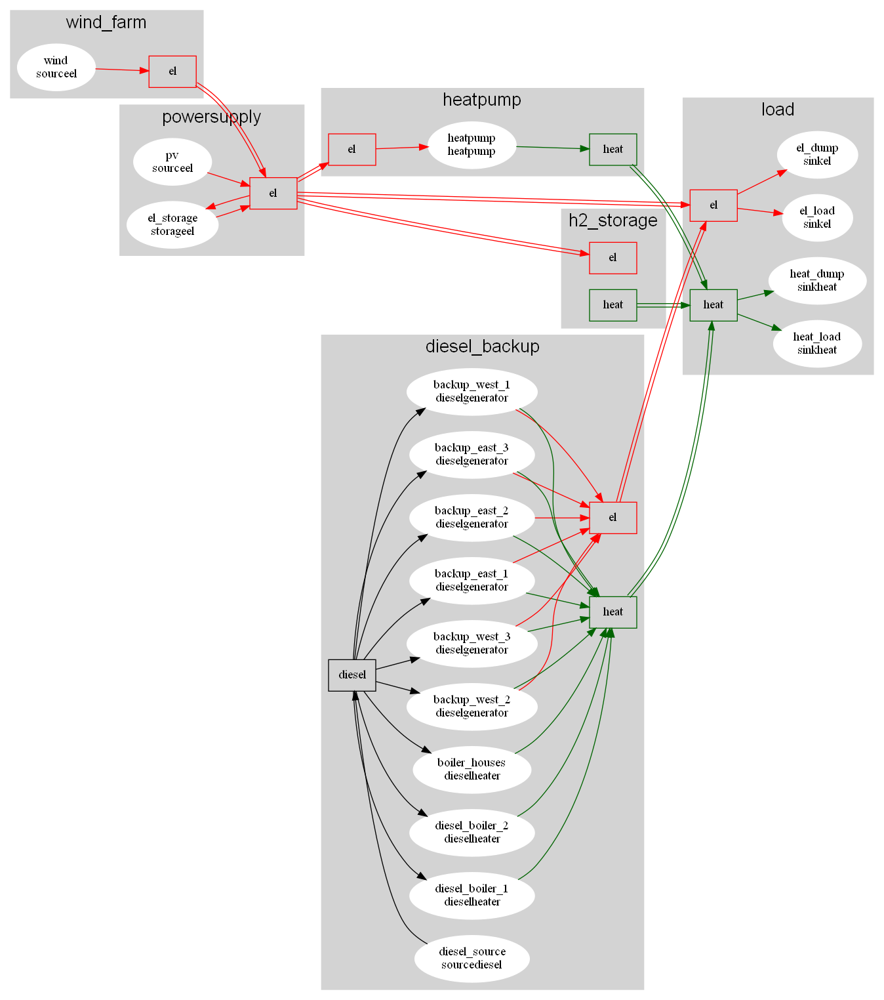

In [333]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
#dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))

### Some checks on input data

In [334]:
25.12, 25.063, 25.081

(25.12, 25.063, 25.081)

In [335]:
print(simulator.optimiser.all_edges['heat_hp_load'].edge_data)

id='heat_hp_load' node_from='heatpump' node_to='load' length_km=None flow_max=None bidirectional=True include=True carrier=<CarrierType.HEAT: 'heat'> power_loss_function=None


## Solve

If the problem is infeasible, try 
* relaxing pressure deviation limits (generic value and per-node value)
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/water/gas has a place to go


In [336]:
dev_d=simulator.optimiser.all_devices["wind"].dev_data
node_d=simulator.optimiser.all_nodes["powersupply"].node_data

In [337]:
#simulator.optimiser.write("testplatform.mps")
sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=20)
print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))
#print("Mean export revenue         =",*["{}:{:.1f} ".format(x,v) for x,v in sim_result.export_revenue.mean().items() if v!=0],"$/s")

100%|██████████| 7/7 [02:06<00:00, 18.09s/it]

Mean CO2 emission rate      = 0.0 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [346]:
sim_result.co2_intensity

0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
       ..
163   NaN
164   NaN
165   NaN
166   NaN
167   NaN
Length: 168, dtype: float64

In [348]:
sum(sim_result.co2_rate*3600)

368.41642524222874

In [353]:
sum(sim_result.co2_rate)*3600*52

19157.654112595916

In [340]:
#simulator.optimiser.updateOptimisationModel(timestep=0,profiles=data.profiles,first=True)
simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

('test.mps', 1569863395232)

In [341]:
#simulator.optimiser.constr_injectionwell_Pmax.pprint()
#simulator.optimiser.constrO_elReserveMargin[6].pprint()
pyo.value(simulator.optimiser.varEdgeFlow["el_ps_load",10])
#simulator.optimiser.constrE_w2_flow.pprint()

1.100000000000001

In [342]:
print(pyo.value(simulator.optimiser.paramProfiles["V105",1]),
    pyo.value(simulator.optimiser.varDeviceIsOn["wind",6]),
    pyo.value(simulator.optimiser.varDeviceIsOn["electrolyser",6]),
    pyo.value(simulator.optimiser.varDeviceIsOn["heatpump",6]),
)

KeyError: "Index '('electrolyser', 6)' is not valid for indexed component 'varDeviceIsOn'"

## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [ ]:
pickle_save='{}case{}.pkl'.format(outpath,case)
# Save (pickle) - for later opening and analysis
dumpdata={"data":data,"result":sim_result}
with open(pickle_save, mode='wb') as file:
   cloudpickle.dump(dumpdata, file)
print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_ir_offshore_pv_diesel.pkl


In [ ]:
# Open previously saved object (including simulation results)
#with open(pickle_save, mode='rb') as file:
#   sim_data = cloudpickle.load(file)
#data=sim_data["data"]
#sim_result=sim_data["result"]

## Analyse results

In [355]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel")#, windturbines=['wind'])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi 

,_ir_offshore_pv_diesel
hours_simulated,168.000000
kgCO2_per_year,19210.285030
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,7276.623118
elconsumption_mwh_per_year,111958.808094
elconsumption_avg_mw,12.780686
gt_starts_per_year,6882.857143
gt_stops_per_year,6674.285714
gt_hoursrunning_per_year,14495.714286
wind_output_mwh_per_year,0.000000


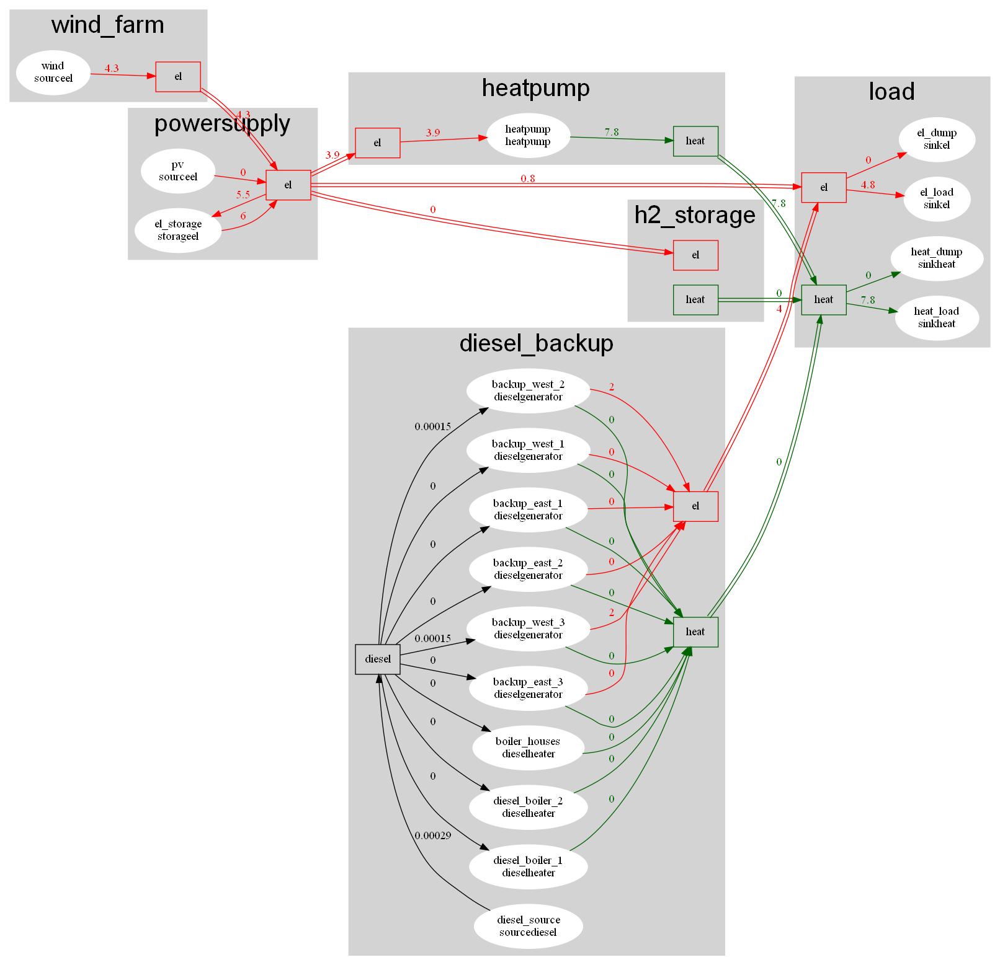

In [344]:
tstep=10
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [ ]:
print(sim_result.device_flow.el_load.el["in"].to_string())

time
0      4.810
1      4.330
2      4.540
3      4.690
4      4.300
5      4.480
6      4.530
7      4.540
8      4.620
9      4.680
10     4.800
11     4.870
12     4.990
13     5.060
14     5.150
15     5.170
16     5.170
17     5.050
18     4.970
19     4.940
20     4.900
21     4.830
22     4.800
23     4.690
24     4.560
25     4.530
26     4.550
27     4.490
28     4.540
29     4.610
30     4.730
31     5.170
32     5.510
33     6.200
34     6.380
35     6.320
36     6.300
37     6.330
38     6.340
39     6.440
40     6.720
41     6.640
42     6.620
43     6.470
44     5.820
45     6.340
46     6.150
47     5.700
48     5.320
49     5.230
50     5.210
51     5.220
52     5.240
53     5.290
54     5.510
55     5.950
56     6.800
57     7.010
58     7.040
59     6.934
60     6.800
61     6.950
62     6.816
63     6.554
64     6.740
65     6.600
66     6.620
67     6.730
68     6.190
69     6.420
70     6.380
71     5.650
72     5.400
73     5.310
74     5.260
75     5.240
76     

In [ ]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.000000e+00
                    1       0.000000e+00
                    2       0.000000e+00
                    3       0.000000e+00
                    4       0.000000e+00
                    5       0.000000e+00
                    6       0.000000e+00
                    7       0.000000e+00
                    8       0.000000e+00
                    9       0.000000e+00
                    10      0.000000e+00
                    11      0.000000e+00
                    12      0.000000e+00
                    13      0.000000e+00
                    14      0.000000e+00
                    15      0.000000e+00
                    16      0.000000e+00
                    17      0.000000e+00
                    18      0.000000e+00
                    19      0.000000e+00
                    20      0.000000e+00
                    21      0.000000e+00
                    22      0.000000e+00
                    23      0.00

In [ ]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

AttributeError: 'OptimisationModel' object has no attribute 'constrN_wells_energybalance'

In [ ]:
plots.plotter='matplotlib'
fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el")#,filename=None,devs_shareload=["wind","pv"])#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutput_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

,el,heat
device,,
el_load,4.832654,0.000000e+00
el_storage,2.845129,0.000000e+00
electrolyser,3.899600,0.000000e+00
fuelcell,0.000000,0.000000e+00
h2_storage,0.000000,0.000000e+00
heat_load,0.000000,6.844884e+00
heatdump,0.000000,1.898043e-16
heatpump,2.951412,0.000000e+00
pv,0.000000,0.000000e+00


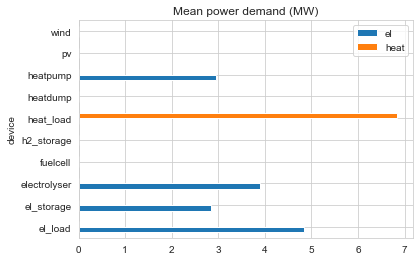

In [ ]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [ ]:
energydemand.sum()

el      14.528796
heat     6.844884
dtype: float64

In [ ]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
el        in          14.528796
          out         14.528796
heat      in           6.844884
          out          6.844884
hydrogen  in           0.462520
          out          0.462520
dtype: float64
Mean flow per device:


carrier             el                    heat           hydrogen         
terminal            in       out            in       out       in      out
device                                                                    
el_load       4.832654  0.000000  0.000000e+00  0.000000  0.00000  0.00000
el_storage    2.845129  2.845271  0.000000e+00  0.000000  0.00000  0.00000
electrolyser  3.899600  0.000000  0.000000e+00  0.238656  0.00000  0.19198
fuelcell      0.000000  1.758509  0.000000e+00  0.703403  0.27054  0.00000
h2_storage    0.000000  0.000000  0.000000e+00  0.000000  0.19198  0.27054
heat_load     0.000000  0.000000  6.844884e+00  0.000000  0.00000  0.00000
heatdump      0.000000  0.000000  1.898043e-16  0.000000  0.00000  0.00000
heatpump      2.951412  0.000000  0.000000e+00  5.902825  0.00000  0.00000
pv            0.000000  2.001293  0.000000e+00  0.000000  0.00000  0.00000
wind          0.000000  7.923723  0.000000e+00  0.000000  0.00000  0.00000

In [ ]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [ ]:
 df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
 df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8750, 8751, 8752, 8753, 8754, 8755, 8756, 8757, 8758, 8759],
           dtype='int64', name='time', length=8760)

In [ ]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
fig.add_scatter(
                x=df.index,
                y=df["wind"],
                line_shape="hv",
                name="wind",
                #line=dict(color=colour[k]),
                stackgroup="P",
                legendgroup="wind",
                row=1,
                col=1,
            )

In [ ]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['heatpump',t].value
    dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
    dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [ ]:
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [ ]:
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)

KeyError: "None of [MultiIndex([('ex_g', 'gas', 'in'),\n            ('ex_o', 'oil', 'in')],\n           names=['device', 'carrier', 'terminal'])] are in the [columns]"

In [ ]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   10 : {'wind', 'pv', 'el_load', 'heat_load', 'electrolyser', 'fuelcell', 'h2_storage', 'el_storage', 'heatpump', 'heatdump'}


In [ ]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',
                                 filename=None)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery',
                filename=None)#outpath+"lastopt_battery.png")

AttributeError: module 'oogeso.plots' has no attribute 'optimization_plots'

In [ ]:
plots.plotter="plotly"
fig=plots.plot_CO2_rate_per_dev(sim_result,simulator.optimiser,reverseLegend=True,filename=outpath+"co2rate_opt.png",devs_shareload=gts)
fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [ ]:
fig=plots.plot_CO2_intensity(sim_result,filename=outpath+"co2intensity_opt.png")
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=0,b=0))

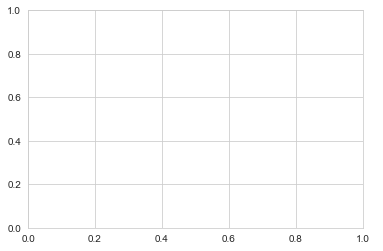

In [ ]:
plots.plotter="matplotlib"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamicMargin=True,includeSum=False)
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
#fig.update_layout(autosize=False,width=700,height=200,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
#fig.update_layout(legend_traceorder="reversed")
#fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [ ]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [ ]:
fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2storage")
fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
fig.show()
fig.write_image(outpath+"h2storage_{}.pdf".format(case))

In [ ]:
simulator.optimiser.all_devices

{'wind': <oogeso.core.devices.source.SourceEl at 0x1eb4201b4f0>,
 'el_load': <oogeso.core.devices.sink.SinkEl at 0x1eb4201b730>,
 'heat1': <oogeso.core.devices.sink.SinkHeat at 0x1eb4201a8f0>,
 'electrolyser': <oogeso.core.devices.electrolyser.Electrolyser at 0x1eb4201b8e0>,
 'fuelcell': <oogeso.core.devices.fuelcell.FuelCell at 0x1eb4201b3d0>,
 'h2storage': <oogeso.core.devices.storage.StorageHydrogen at 0x1eb4201b550>,
 'heatpump': <oogeso.core.devices.heatpump.HeatPump at 0x1eb4201b9d0>}